## **1. CLONING THE REPOSITORY**

In [1]:
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

Cloning into 'yolov5'...
remote: Enumerating objects: 9909, done.
remote: Total 9909 (delta 0), reused 0 (delta 0), pack-reused 9909
Receiving objects: 100% (9909/9909), 10.09 MiB | 28.69 MiB/s, done.
Resolving deltas: 100% (6896/6896), done.
/content/yolov5
HEAD is now at 886f1c0 DDP after autoanchor reorder (#2421)


1.2 Installing the Pre-Requisites for "You Only Look Once" Ver.5 Model

In [2]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.google_utils import gdrive_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 596 kB 5.0 MB/s 
Setup complete. Using torch 1.9.0+cu111 CPU


## **2. DATA IMPORT**

2.1 Client - URL from Roboflow to obtain dataset anotated with YOLOV5 format

In [6]:
%cd /content/
!curl -L "https://app.roboflow.com/ds/_____" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

/content
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1513      0 --:--:-- --:--:-- --:--:--  1513
100 72.4M  100 72.4M    0     0  65.5M      0  0:00:01  0:00:01 --:--:--  170M
Archive:  roboflow.zip
replace README.dataset.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: Y
 extracting: README.dataset.txt      
replace README.roboflow.txt? [y]es, [n]o, [A]ll, [N]one, [r]ename: A
 extracting: README.roboflow.txt     
 extracting: data.yaml               
 extracting: test/images/image_000000010_jpg.rf.dceb40b76c7104fc6a5c91541cc12c77.jpg  
 extracting: test/images/image_000000023_jpg.rf.d39e8a8180b0f800a28d3451f7fa60f7.jpg  
 extracting: test/images/image_000000027_jpg.rf.ef611718855c8fb1670e3e95527ae168.jpg  
 extracting: test/images/image_000000030_jpg.rf.9dce4ad4f7dee847fe1dff5c0ce4114e.jpg  
 extracting: test/images/image_000000032_jpg.rf.509d1

In [18]:
%cd /content/yolov5

[Errno 2] No such file or directory: '/content/ yolov5/'
/content/yolov5


In [19]:
!curl -L "https://app.roboflow.com/ds/______" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   896  100   896    0     0   1656      0 --:--:-- --:--:-- --:--:--  1656
100 72.4M  100 72.4M    0     0  79.9M      0 --:--:-- --:--:-- --:--:--  329M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
 extracting: data.yaml               
   creating: test/
   creating: test/images/
 extracting: test/images/image_000000010_jpg.rf.dceb40b76c7104fc6a5c91541cc12c77.jpg  
 extracting: test/images/image_000000023_jpg.rf.d39e8a8180b0f800a28d3451f7fa60f7.jpg  
 extracting: test/images/image_000000027_jpg.rf.ef611718855c8fb1670e3e95527ae168.jpg  
 extracting: test/images/image_000000030_jpg.rf.9dce4ad4f7dee847fe1dff5c0ce4114e.jpg  
 extracting: test/images/image_000000032_jpg.rf.509d1ae6b118516a85e923297973b14f.jpg  
 extracting: test/images/image_000000047_jpg.rf.bd51b7d00bd9a06b535

2.2 Reading the "data.yaml" (From Data Import 2.1)

In [7]:
import yaml
with open('/content/data.yaml','r') as stream:
  num_classes = str(yaml.safe_load(stream)['nc'])

In [8]:
from IPython.core.magic import register_line_cell_magic
@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

## **3. MODELLING**

3.1 Modification of YOLO V5 Model

In [9]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

  # YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

3.2 Training the YOLOv5 Model 

In [15]:
%cd /content/yolov5

/content/yolov5


In [ ]:
%%time
!python train.py --img 416 --batch 16 --epochs 100 --data {'/content/yolov5'}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

github: ⚠️ WARNING: code is out of date by 612 commits. Use 'git pull' to update or 'git clone https://github.com/ultralytics/yolov5' to download latest.
YOLOv5 v4.0-126-g886f1c0 torch 1.9.0+cu111 CPU

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='./models/custom_yolov5s.yaml', data='/content/yolov5/data.yaml', device='', entity=None, epochs=100, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], linear_lr=False, local_rank=-1, log_artifacts=False, log_imgs=16, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5s_results', single_cls=False, sync_bn=False, total_batch_size=16, weights='', workers=8, world_size=1)
wandb: Install Weights & Biases for YOLOv5 logging with 'pip install wandb' (recommended)
Start Tensorboard with "tensorboard --logdir runs/train", view at http:

3.3 Model Performance Estimation

In [11]:
 
from utils.plots import plot_results
Image(filename='/content/yolov5/runs/train/yolov5s_results/results.png', width=1000)

FileNotFoundError: ignored

In [34]:
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='../test/images', update=False, view_img=False, weights=['runs/train/yolov5s_results/weights/best.pt'])
YOLOv5 v4.0-126-g886f1c0 torch 1.9.0+cu111 CUDA:0 (Tesla K80, 11441.1875MB)

Fusing layers... 
/usr/local/lib/python3.7/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
Model Summary: 232 layers, 7249215 parameters, 0 gradients, 16.8 GFLOPS
image 1/224 /content/yolov5/../test/images/image_000000010_jpg.rf.dceb40b76c7104fc6a5c91541cc12c77.jpg

3.4 Visualizing the Outputs

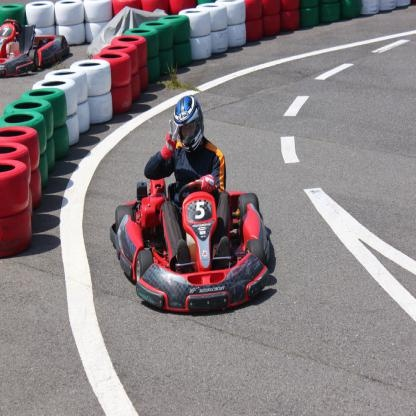

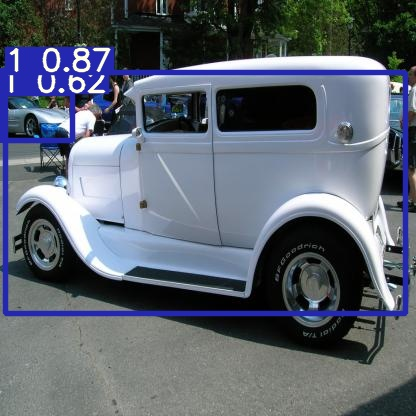

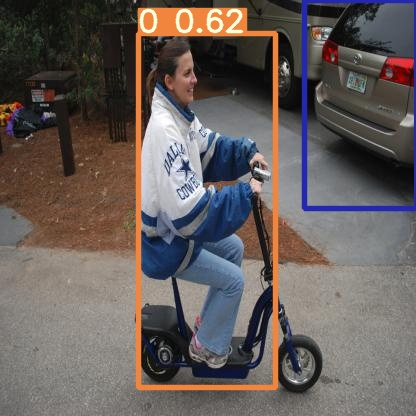

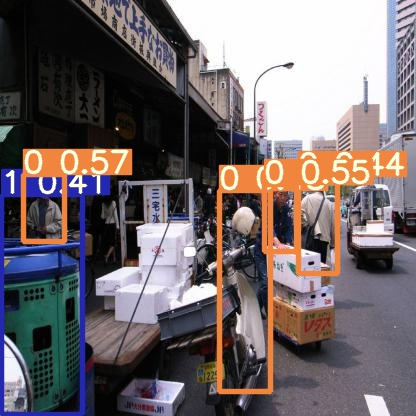

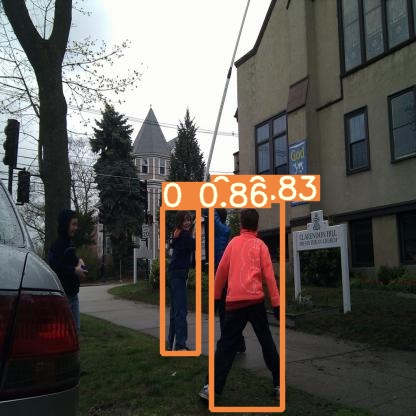

...

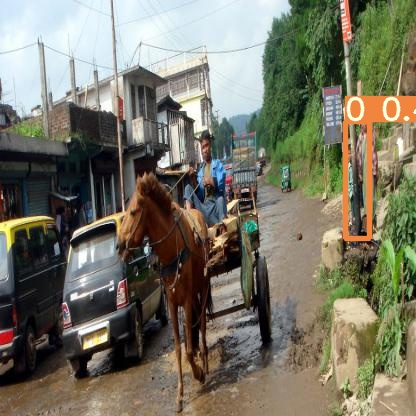

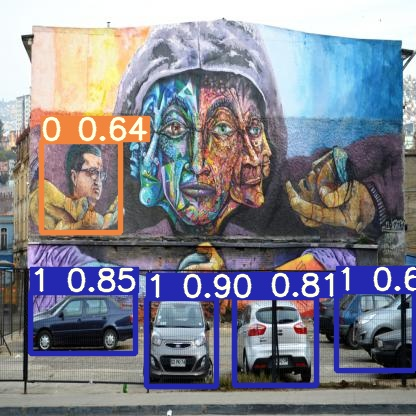

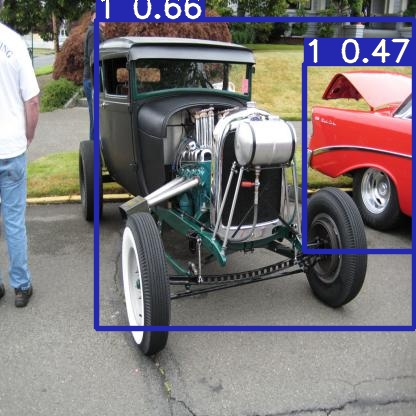

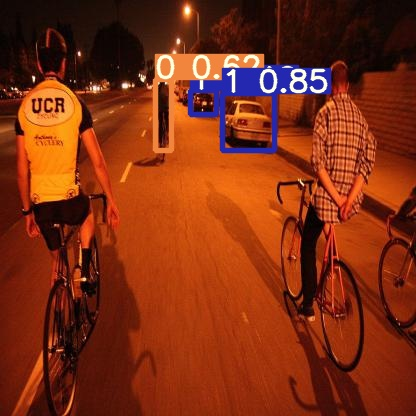

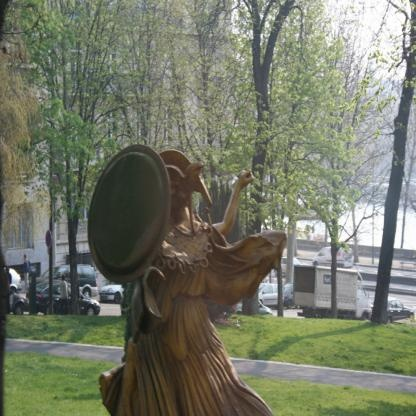

In [35]:
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

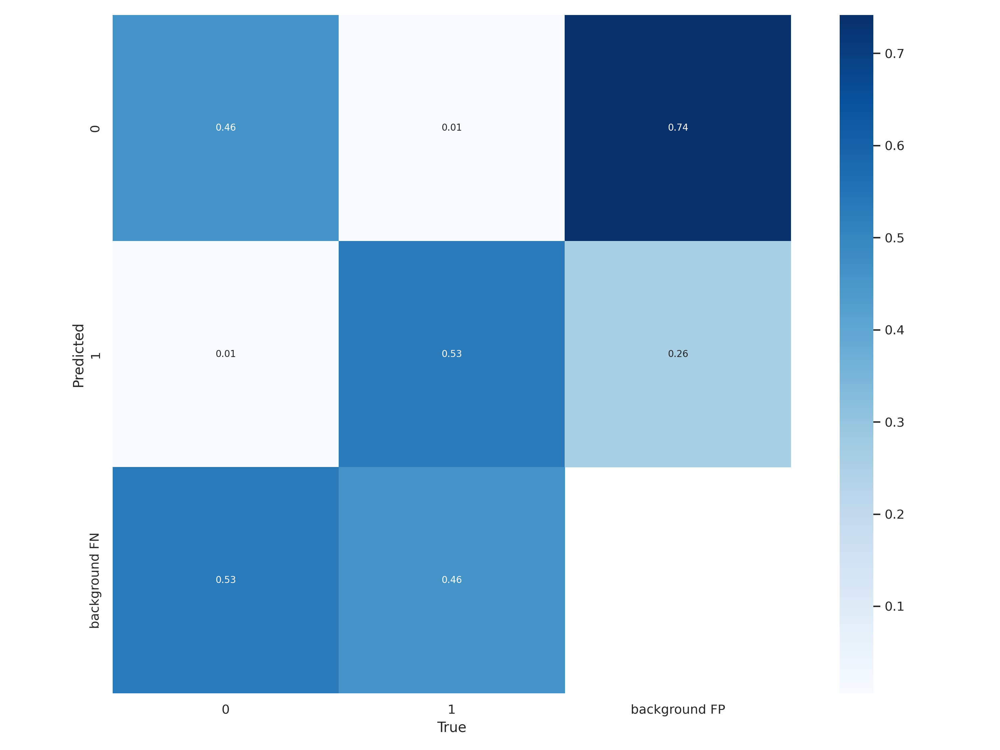

In [38]:
Image(filename='/content/yolov5/runs/train/yolov5s_results/confusion_matrix.png', width=1000)